Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Processing /content/drive/MyDrive/Assignment3/image 3.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 3.jpg: 480x640 1 person, 4 cars, 1206.5ms
Speed: 4.2ms preprocess, 1206.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


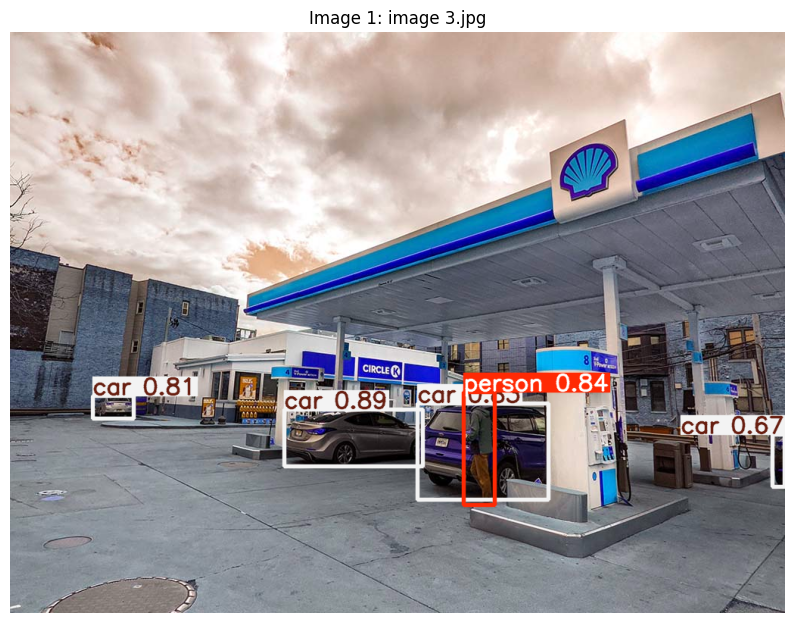

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_1.jpg

Processing /content/drive/MyDrive/Assignment3/image 4.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 4.jpg: 480x640 4 persons, 1 tie, 1 keyboard, 1245.9ms
Speed: 5.2ms preprocess, 1245.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


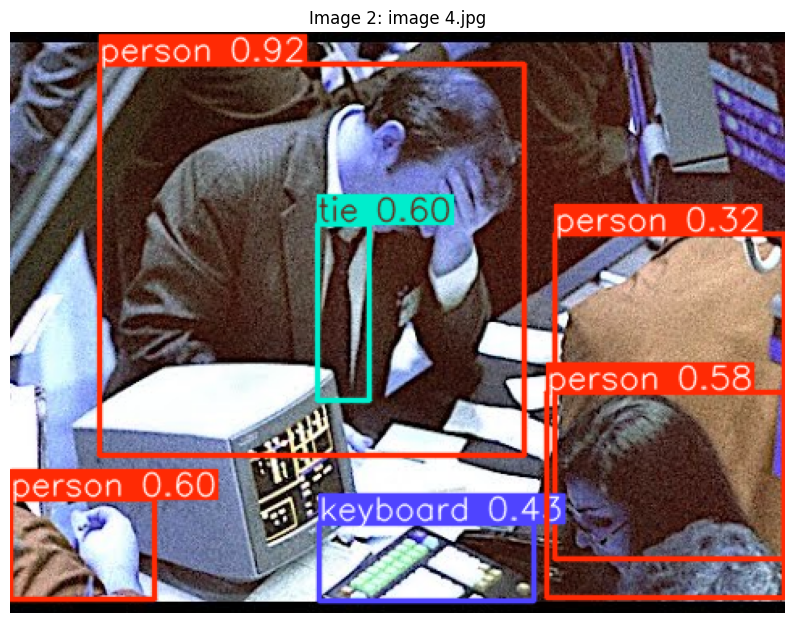

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_2.jpg

Processing /content/drive/MyDrive/Assignment3/image 5.jpeg...

image 1/1 /content/drive/MyDrive/Assignment3/image 5.jpeg: 384x640 4 persons, 1 sports ball, 1 skateboard, 1 tv, 1067.6ms
Speed: 3.9ms preprocess, 1067.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


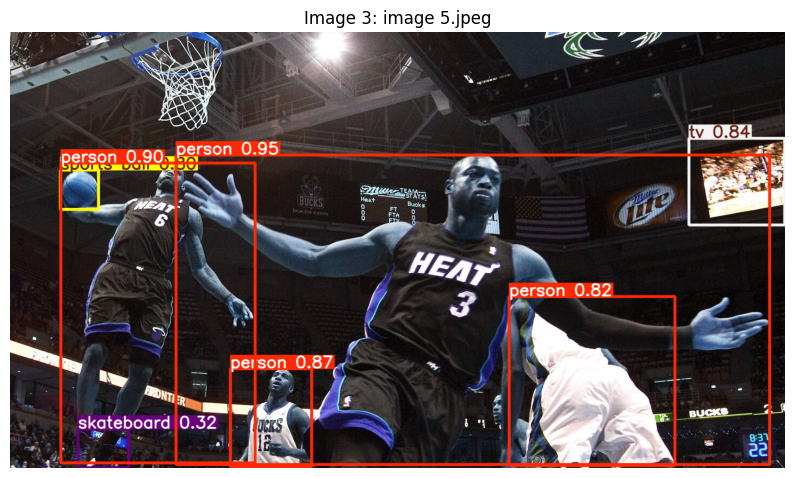

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_3.jpg

Processing /content/drive/MyDrive/Assignment3/image 6.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 6.jpg: 448x640 9 persons, 2 bicycles, 13 cars, 1 bus, 8 traffic lights, 2 handbags, 1 skateboard, 1151.4ms
Speed: 4.7ms preprocess, 1151.4ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)


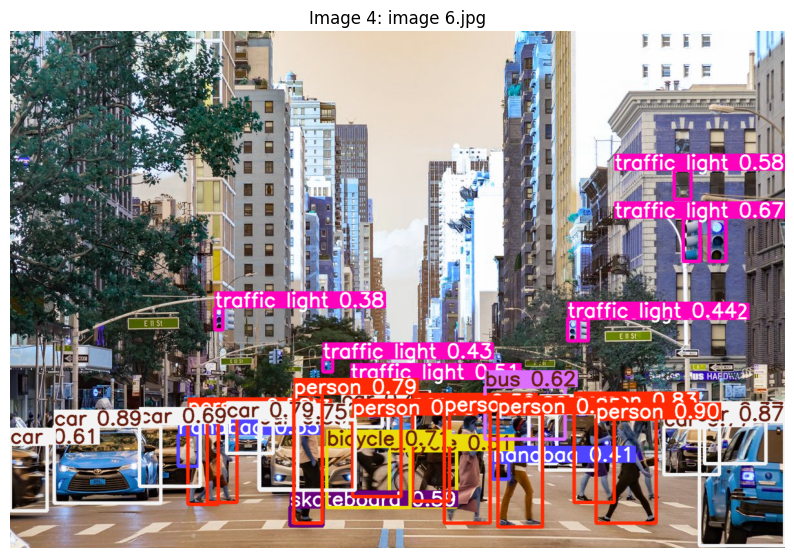

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_4.jpg

Processing /content/drive/MyDrive/Assignment3/image 7.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 7.jpg: 384x640 13 persons, 1 baseball bat, 1134.9ms
Speed: 3.5ms preprocess, 1134.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


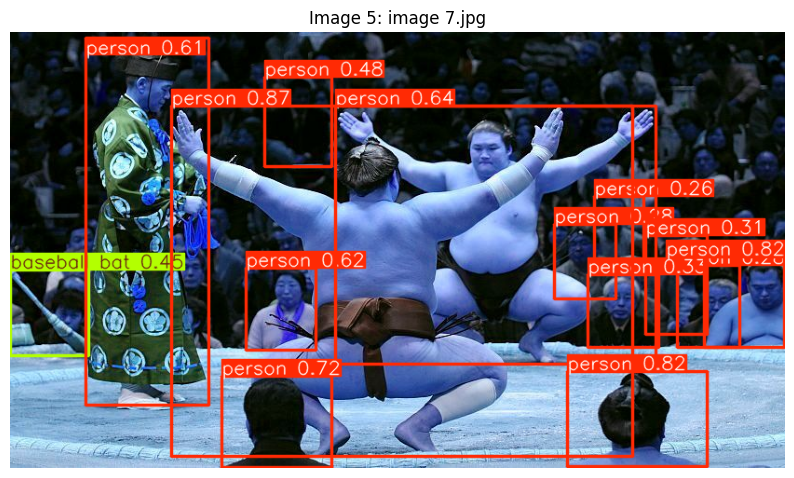

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_5.jpg

Processing /content/drive/MyDrive/Assignment3/image 1.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 1.jpg: 448x640 12 persons, 2 cars, 1 truck, 4 traffic lights, 1 bench, 1 bottle, 1 cup, 1 pizza, 1 cell phone, 1796.0ms
Speed: 8.8ms preprocess, 1796.0ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)


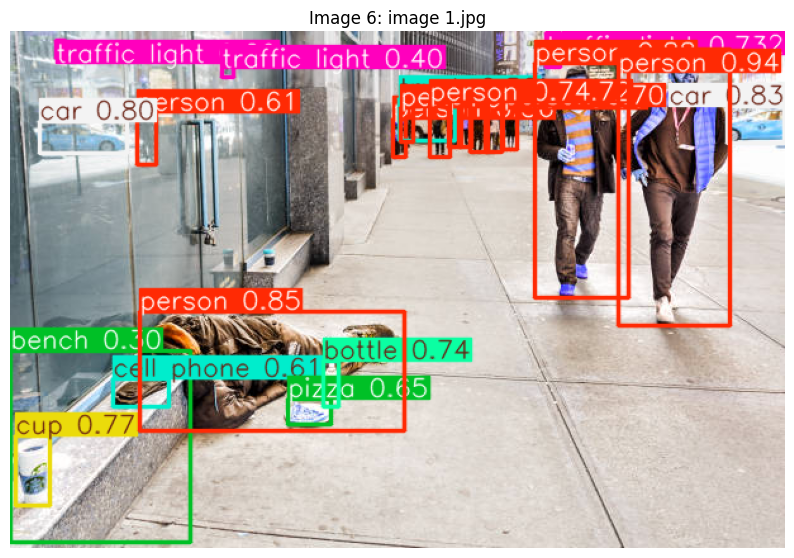

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_6.jpg

Processing /content/drive/MyDrive/Assignment3/image 2.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 2.jpg: 448x640 1 person, 1 bottle, 1 potted plant, 1 tv, 1 vase, 1 teddy bear, 1695.6ms
Speed: 4.5ms preprocess, 1695.6ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


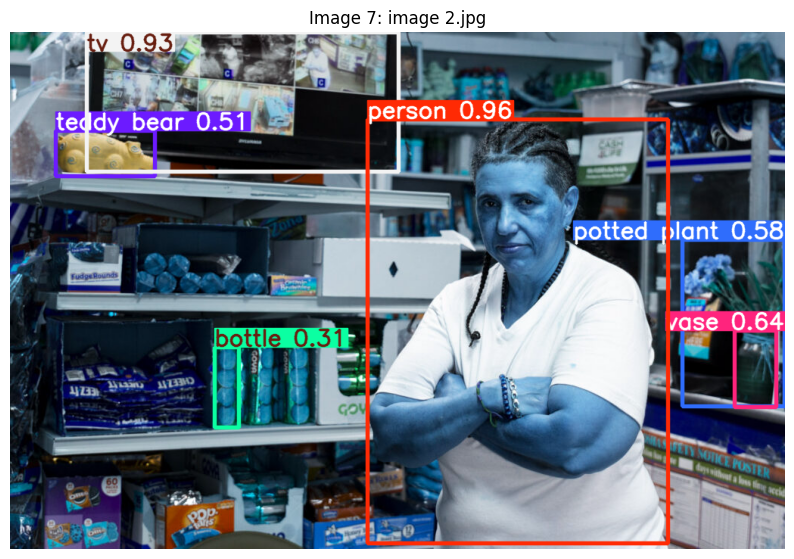

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_7.jpg


Results Table


,Image,Detection Time (s),Number of Objects Detected,Classes Detected,Confidence Probabilities
0,image 3.jpg,1.81,5,"[car, person, car, car, car]","[0.8948, 0.8449, 0.8293, 0.8071, 0.6705]"
1,image 4.jpg,1.27,6,"[person, person, tie, person, keyboard, person]","[0.9166, 0.6018, 0.5986, 0.5796, 0.4263, 0.3231]"
2,image 5.jpeg,1.09,7,"[person, person, person, tv, person, sports ba...","[0.946, 0.9027, 0.8718, 0.8371, 0.8177, 0.8032..."
3,image 6.jpg,1.20,36,"[person, car, car, person, person, person, per...","[0.9038, 0.8868, 0.8688, 0.8496, 0.8327, 0.816..."
4,image 7.jpg,1.17,14,"[person, person, person, person, person, perso...","[0.8665, 0.8241, 0.82, 0.7202, 0.6353, 0.6236,..."
5,image 1.jpg,1.83,24,"[person, person, person, car, car, cup, bottle...","[0.9371, 0.8822, 0.8476, 0.8344, 0.8024, 0.765..."
6,image 2.jpg,1.73,6,"[person, tv, vase, potted plant, teddy bear, b...","[0.957, 0.9276, 0.6369, 0.5773, 0.5137, 0.3069]"



Results have been saved to: /content/drive/MyDrive/Assignment3/object_detection_results.csv


In [12]:
# Step 1: Install required libraries
!pip install ultralytics torch torchvision opencv-python pandas numpy

# Step 2: Import necessary libraries
from ultralytics import YOLO
from PIL import Image
import matplotlib.pyplot as plt
import os
import pandas as pd
import time  # For tracking detection time
from google.colab import drive

# Step 3: Mount Google Drive
drive.mount('/content/drive')

# Step 4: Initialize YOLO model (using YOLOv8 Medium weights)
model = YOLO("yolov8m.pt")

# Path to the folder containing the images
image_folder = "/content/drive/MyDrive/Assignment3"

# Get list of images (only jpg, png, or jpeg files)
image_paths = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith(('.jpg', '.jpeg', '.png'))]

# Limit the number of images to process to 7
image_paths = image_paths[:7]

# Step 5: Results storage
results_list = []

# Step 6: Loop through each image, predict, annotate, and save the results
for i, image_path in enumerate(image_paths):
    try:
        print(f'Processing {image_path}...')

        # Start the timer
        start_time = time.time()

        # Run YOLO prediction on the image
        results = model.predict(image_path)
        result = results[0]  # The result contains detected objects

        # Stop the timer and calculate detection time
        detection_time = time.time() - start_time

        # Annotate the image with YOLO-detected objects
        annotated_image = result.plot()

        # Display the annotated image
        plt.figure(figsize=(10, 10))
        plt.imshow(annotated_image)
        plt.axis('off')  # Turn off the axes for better visualization
        plt.title(f"Image {i+1}: {os.path.basename(image_path)}")
        plt.show()

        # Convert the NumPy array to a PIL Image
        annotated_image_pil = Image.fromarray(annotated_image)

        # Save the annotated image to Google Drive
        output_path = os.path.join(image_folder, f"annotated_image_{i+1}.jpg")
        annotated_image_pil.save(output_path)

        print(f"Annotated image saved as: {output_path}\n")

        # Extract detection information from YOLO results
        num_objects = len(result.boxes)
        classes = result.boxes.cls.tolist()
        confidences = result.boxes.conf.tolist()

        # Convert class indices to YOLO class names
        class_names = [model.names[int(cls)] for cls in classes]

        # Store results for this image
        results_list.append({
            'Image': os.path.basename(image_path),
            'Detection Time (s)': round(detection_time, 2),
            'Number of Objects Detected': num_objects,
            'Classes Detected': class_names,
            'Confidence Probabilities': [round(conf, 4) for conf in confidences]
        })

    except Exception as e:
        print(f"Error processing {image_path}: {e}")

# Step 7: Create a DataFrame to store and display the results
results_df = pd.DataFrame(results_list)

# Display results as a table
print("\nResults Table")
display(results_df)

# Step 8: Save the results as a CSV file in your Google Drive
csv_path = '/content/drive/MyDrive/Assignment3/object_detection_results.csv'
results_df.to_csv(csv_path, index=False)

# Print the location of the saved file
print(f"\nResults have been saved to: {csv_path}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Processing /content/drive/MyDrive/Assignment3/image 3.jpg...


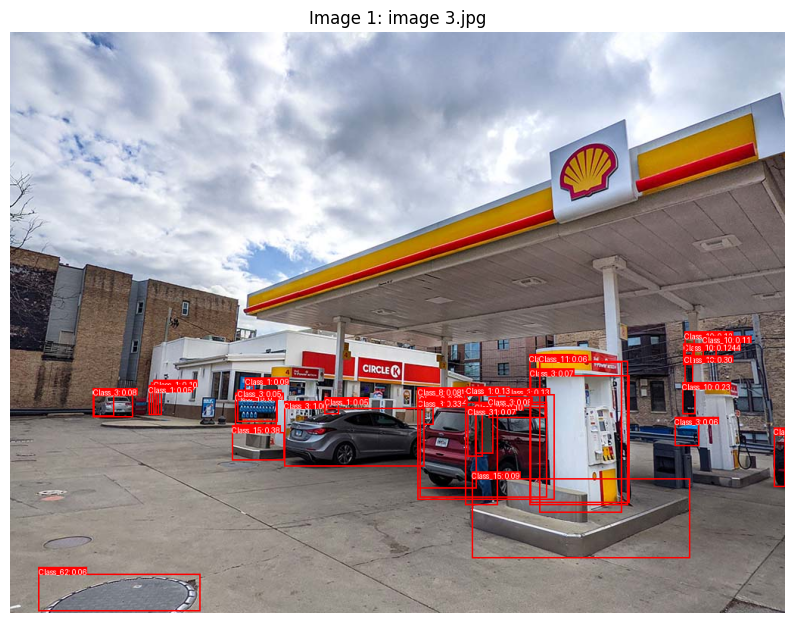

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_faster_rcnn_image_1.jpg

Processing /content/drive/MyDrive/Assignment3/image 4.jpg...


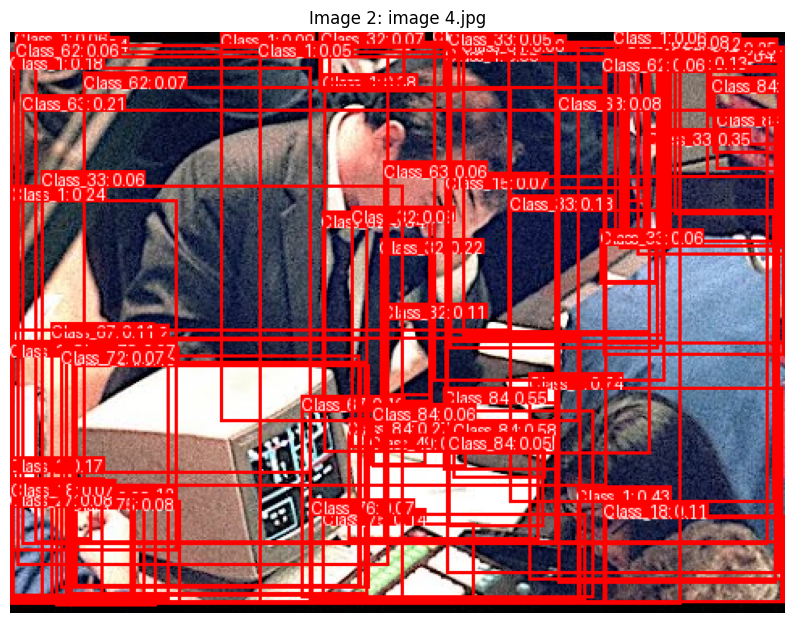

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_faster_rcnn_image_2.jpg

Processing /content/drive/MyDrive/Assignment3/image 5.jpeg...


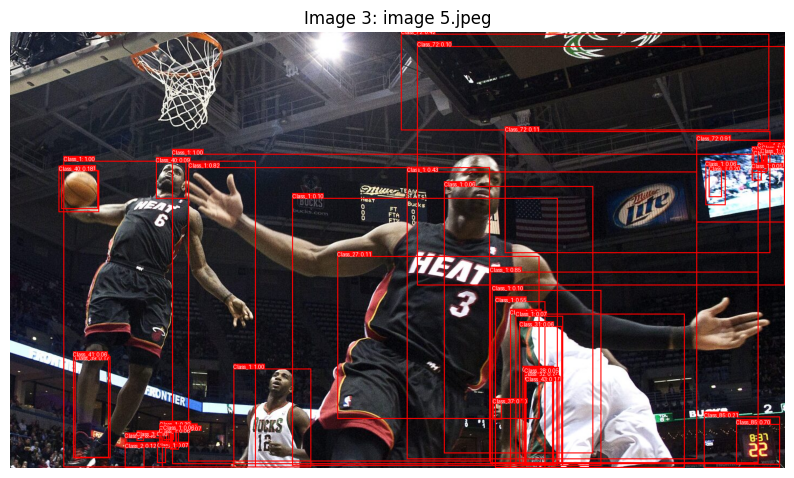

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_faster_rcnn_image_3.jpg

Processing /content/drive/MyDrive/Assignment3/image 6.jpg...


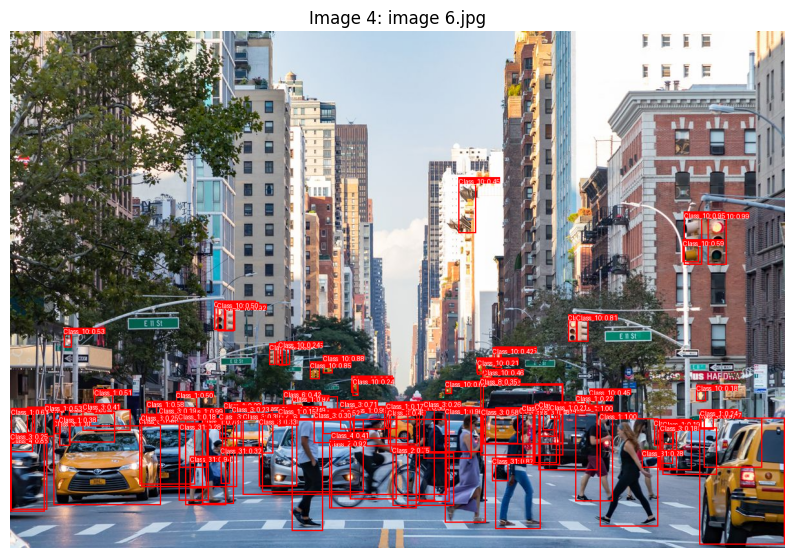

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_faster_rcnn_image_4.jpg

Processing /content/drive/MyDrive/Assignment3/image 7.jpg...


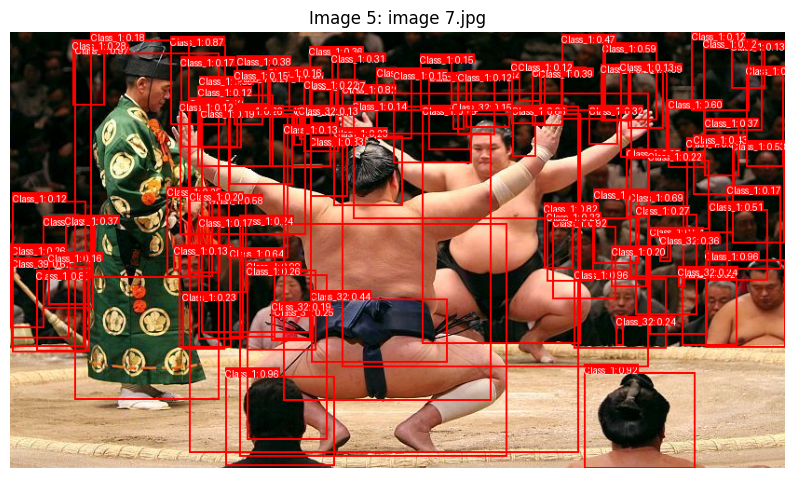

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_faster_rcnn_image_5.jpg

Processing /content/drive/MyDrive/Assignment3/image 1.jpg...


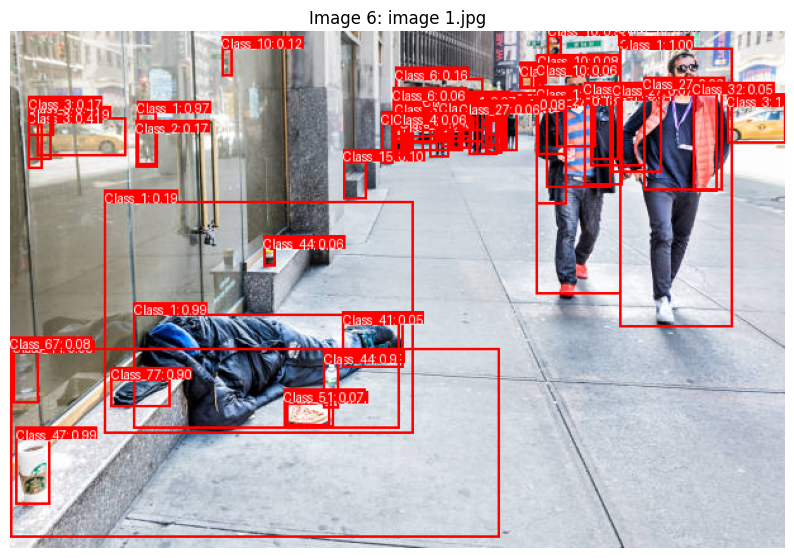

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_faster_rcnn_image_6.jpg

Processing /content/drive/MyDrive/Assignment3/image 2.jpg...


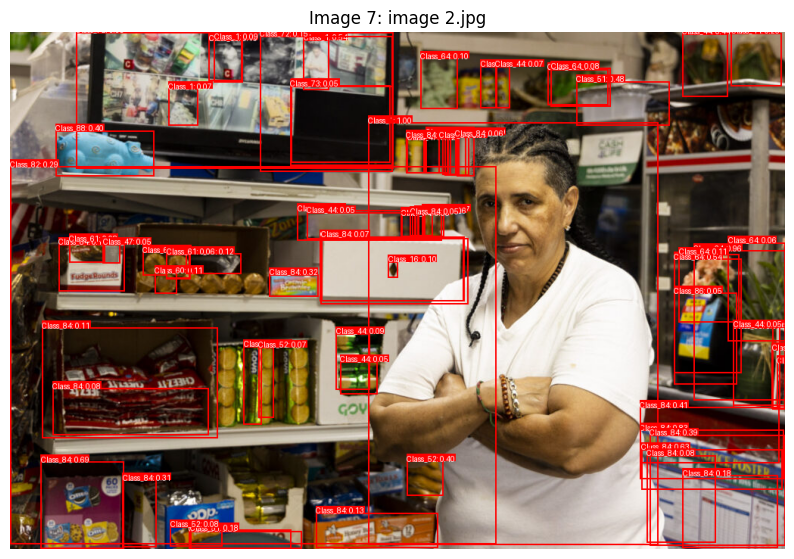

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_faster_rcnn_image_7.jpg


Results Table


,Image,Faster R-CNN Detection Time (s),Faster R-CNN Objects Detected,Faster R-CNN Classes Detected,Faster R-CNN Confidence Probabilities
0,image 3.jpg,15.28,35,"[Class_3, Class_3, Class_1, Class_3, Class_3, ...","[0.9963, 0.9959, 0.991, 0.9851, 0.9382, 0.4397..."
1,image 4.jpg,7.93,75,"[Class_1, Class_73, Class_32, Class_1, Class_8...","[0.9372, 0.8871, 0.8358, 0.7362, 0.5808, 0.580..."
2,image 5.jpeg,11.07,51,"[Class_1, Class_1, Class_1, Class_37, Class_72...","[0.999, 0.9962, 0.9956, 0.9825, 0.907, 0.853, ..."
3,image 6.jpg,11.47,100,"[Class_3, Class_1, Class_1, Class_1, Class_10,...","[0.9988, 0.998, 0.9979, 0.9928, 0.9912, 0.9912..."
4,image 7.jpg,10.57,100,"[Class_1, Class_1, Class_1, Class_1, Class_1, ...","[0.993, 0.9929, 0.9692, 0.9643, 0.9606, 0.9605..."
5,image 1.jpg,9.27,78,"[Class_1, Class_1, Class_3, Class_3, Class_44,...","[0.9997, 0.9996, 0.9962, 0.9929, 0.9924, 0.991..."
6,image 2.jpg,10.57,79,"[Class_1, Class_64, Class_86, Class_84, Class_...","[0.9991, 0.9639, 0.9637, 0.8315, 0.6943, 0.684..."



Results have been saved to: /content/drive/MyDrive/Assignment3/faster_rcnn_object_detection_results.csv


In [20]:
# Step 1: Install required libraries
!pip install torch torchvision opencv-python pandas numpy

# Step 2: Import necessary libraries
import torch
import torchvision
from torchvision.transforms import functional as F
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import os
import pandas as pd
import time  # For tracking detection time
from google.colab import drive

# Step 3: Mount Google Drive
drive.mount('/content/drive')

# Step 4: Initialize Faster R-CNN model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
faster_rcnn_model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True).to(device)
faster_rcnn_model.eval()  # Set model to evaluation mode

# Path to the folder containing the images
image_folder = "/content/drive/MyDrive/Assignment3"

# Get list of images (only jpg, png, or jpeg files)
image_paths = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith(('.jpg', '.jpeg', '.png'))]

# Limit the number of images to process to 7
image_paths = image_paths[:7]

# Step 5: Results storage
results_list = []

# Step 6: Loop through each image, predict, annotate, and save the results
for i, image_path in enumerate(image_paths):
    try:
        print(f'Processing {image_path}...')

        # Load the image and convert it to tensor
        image = Image.open(image_path).convert("RGB")
        image_tensor = F.to_tensor(image).unsqueeze(0).to(device)  # Convert to tensor and add batch dimension

        ####### FASTER R-CNN #######
        # Start the timer
        start_time = time.time()

        # Run Faster R-CNN prediction
        with torch.no_grad():
            faster_rcnn_results = faster_rcnn_model(image_tensor)

        # Stop the timer and calculate detection time
        detection_time_faster_rcnn = time.time() - start_time

        # Extract information from Faster R-CNN results
        num_objects_faster_rcnn = len(faster_rcnn_results[0]['labels'])
        boxes = faster_rcnn_results[0]['boxes'].tolist()
        classes_faster_rcnn = faster_rcnn_results[0]['labels'].tolist()
        confidences_faster_rcnn = faster_rcnn_results[0]['scores'].tolist()

        # Get class names from COCO dataset (optional)
        class_names_faster_rcnn = [f"Class_{cls}" for cls in classes_faster_rcnn]

        # Draw bounding boxes and class labels on the image
        image_annotated = image.copy()
        draw = ImageDraw.Draw(image_annotated)

        # Use default font
        try:
            font = ImageFont.truetype("arial.ttf", 20)
        except:
            font = ImageFont.load_default()

        for box, label, score in zip(boxes, classes_faster_rcnn, confidences_faster_rcnn):
            x1, y1, x2, y2 = box
            draw.rectangle([x1, y1, x2, y2], outline="red", width=2)
            label_text = f"{f'Class_{label}'}: {score:.2f}"

            # Calculate the size of the text to create a background
            text_bbox = font.getbbox(label_text)
            text_width, text_height = text_bbox[2] - text_bbox[0], text_bbox[3] - text_bbox[1]
            text_background = [x1, y1 - text_height, x1 + text_width, y1]

            draw.rectangle(text_background, fill="red")
            draw.text((x1, y1 - text_height), label_text, fill="white", font=font)

        # Display the image with bounding boxes
        plt.figure(figsize=(10, 10))
        plt.imshow(image_annotated)
        plt.axis('off')  # Turn off the axes for better visualization
        plt.title(f"Image {i+1}: {os.path.basename(image_path)}")
        plt.show()

        # Save the annotated image to Google Drive
        output_path = os.path.join(image_folder, f"annotated_faster_rcnn_image_{i+1}.jpg")
        image_annotated.save(output_path)

        print(f"Annotated image saved as: {output_path}\n")

        # Store results for this image
        results_list.append({
            'Image': os.path.basename(image_path),
            'Faster R-CNN Detection Time (s)': round(detection_time_faster_rcnn, 2),
            'Faster R-CNN Objects Detected': num_objects_faster_rcnn,
            'Faster R-CNN Classes Detected': class_names_faster_rcnn,
            'Faster R-CNN Confidence Probabilities': [round(conf, 4) for conf in confidences_faster_rcnn],
        })

    except Exception as e:
        print(f"Error processing {image_path}: {e}")

# Step 7: Create a DataFrame to store and display the results
results_df = pd.DataFrame(results_list)

# Display results as a table
print("\nResults Table")
display(results_df)

# Step 8: Save the results as a CSV file in your Google Drive
csv_path = '/content/drive/MyDrive/Assignment3/faster_rcnn_object_detection_results.csv'
results_df.to_csv(csv_path, index=False)

# Print the location of the saved file
print(f"\nResults have been saved to: {csv_path}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MaskRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=MaskRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Processing /content/drive/MyDrive/Assignment3/image 3.jpg...


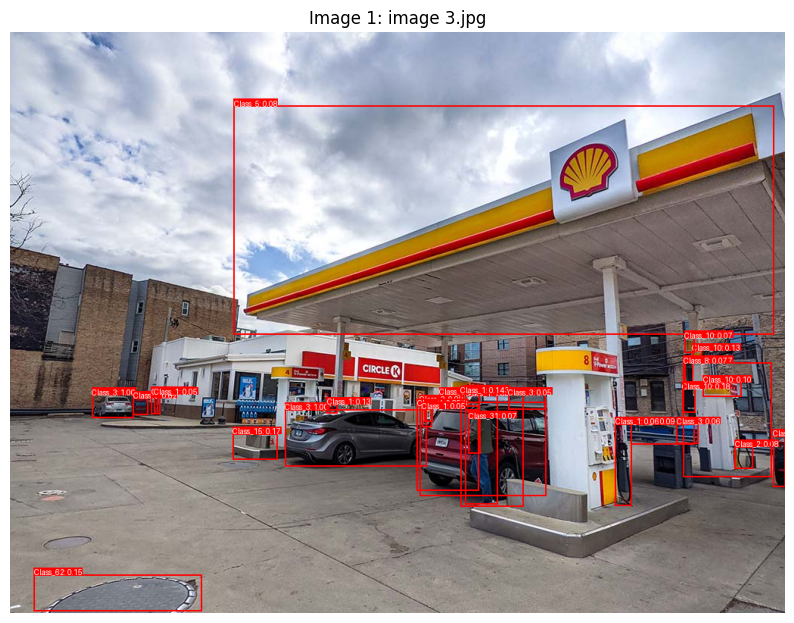

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_mask_rcnn_image_1.jpg

Processing /content/drive/MyDrive/Assignment3/image 4.jpg...


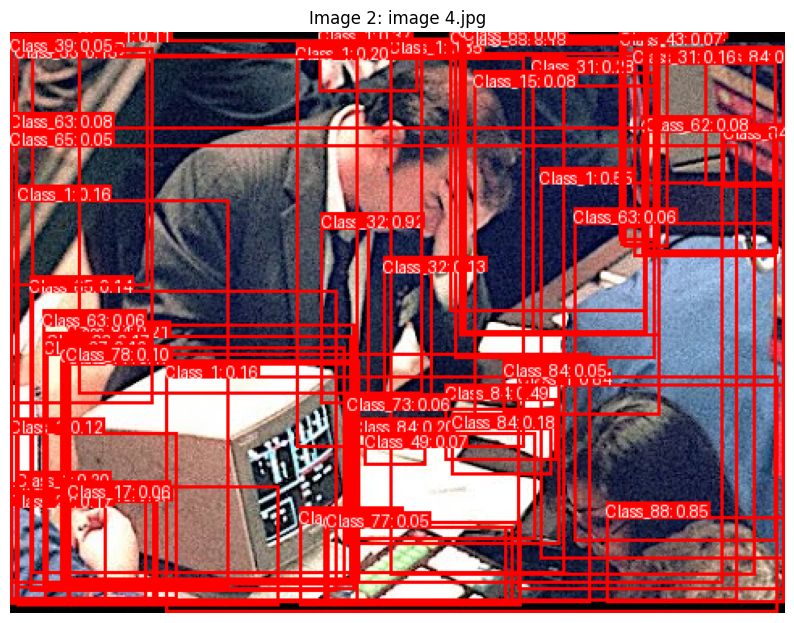

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_mask_rcnn_image_2.jpg

Processing /content/drive/MyDrive/Assignment3/image 5.jpeg...


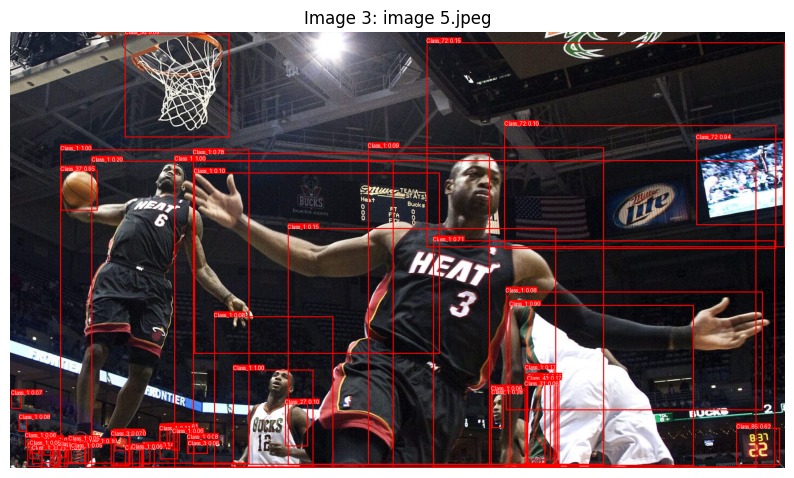

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_mask_rcnn_image_3.jpg

Processing /content/drive/MyDrive/Assignment3/image 6.jpg...


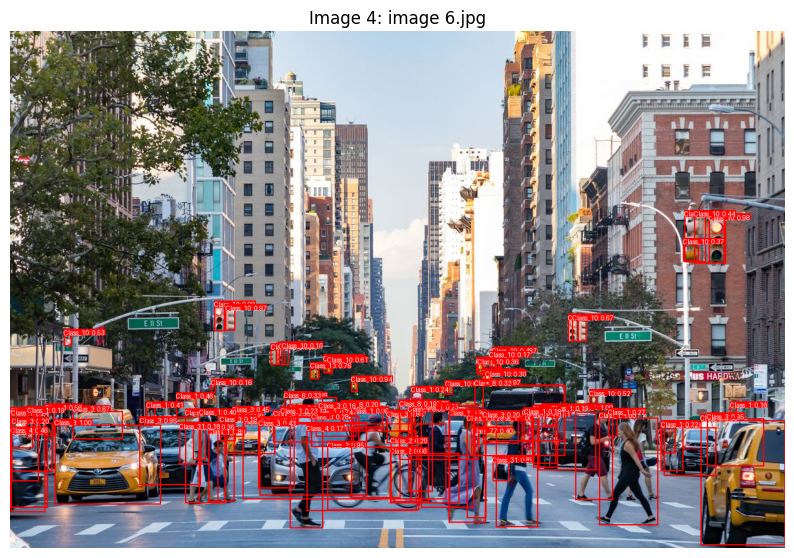

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_mask_rcnn_image_4.jpg

Processing /content/drive/MyDrive/Assignment3/image 7.jpg...


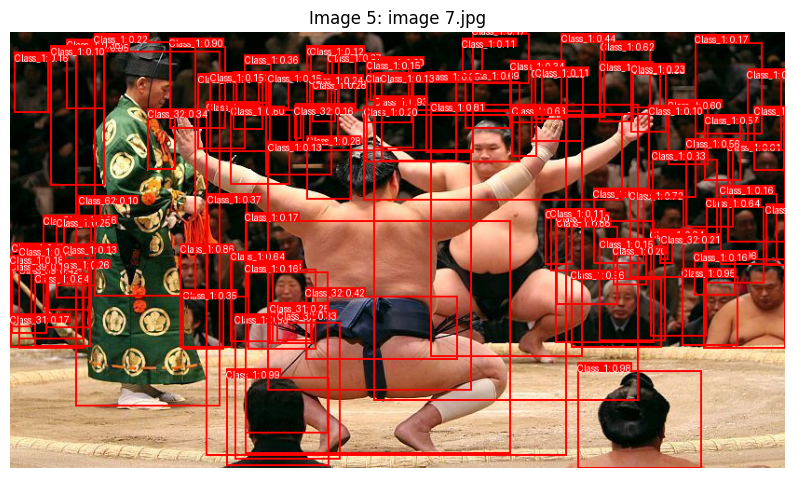

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_mask_rcnn_image_5.jpg

Processing /content/drive/MyDrive/Assignment3/image 1.jpg...


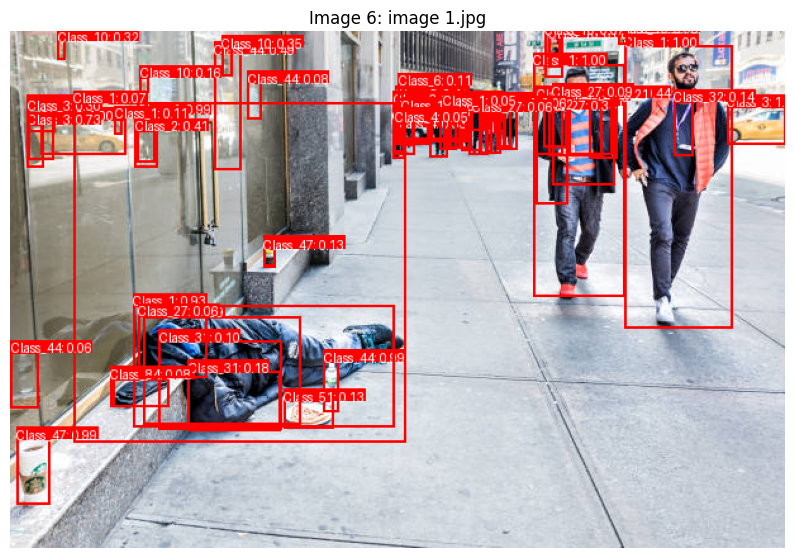

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_mask_rcnn_image_6.jpg

Processing /content/drive/MyDrive/Assignment3/image 2.jpg...


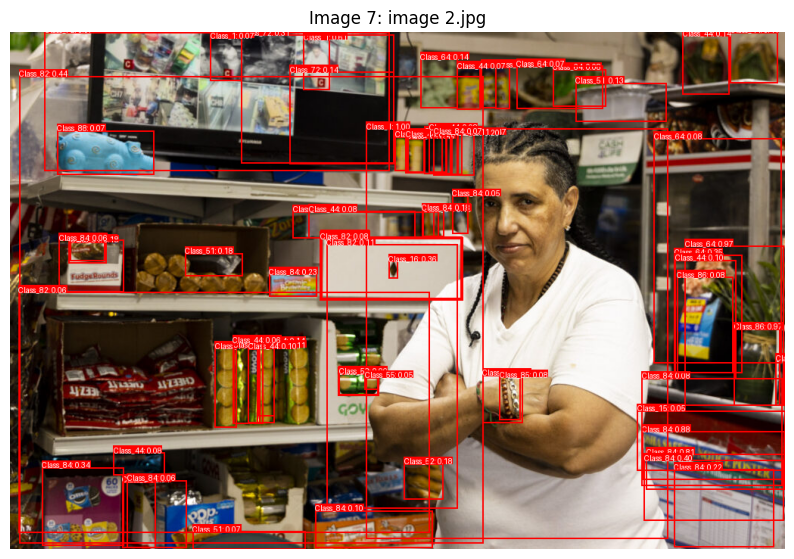

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_mask_rcnn_image_7.jpg


Results Table


,Image,Mask R-CNN Detection Time (s),Mask R-CNN Objects Detected,Mask R-CNN Classes Detected,Mask R-CNN Confidence Probabilities
0,image 3.jpg,9.04,30,"[Class_3, Class_1, Class_3, Class_3, Class_3, ...","[0.9968, 0.9966, 0.9958, 0.9772, 0.9602, 0.621..."
1,image 4.jpg,11.06,59,"[Class_1, Class_32, Class_88, Class_1, Class_7...","[0.9872, 0.918, 0.8544, 0.8421, 0.8233, 0.7989..."
2,image 5.jpeg,13.43,57,"[Class_1, Class_1, Class_1, Class_37, Class_72...","[0.9991, 0.996, 0.9953, 0.9499, 0.9383, 0.8999..."
3,image 6.jpg,13.48,100,"[Class_1, Class_1, Class_1, Class_3, Class_1, ...","[0.9984, 0.9984, 0.9966, 0.9956, 0.9928, 0.987..."
4,image 7.jpg,13.64,100,"[Class_1, Class_1, Class_1, Class_1, Class_1, ...","[0.9955, 0.9915, 0.9842, 0.9827, 0.9636, 0.959..."
5,image 1.jpg,10.91,68,"[Class_1, Class_1, Class_3, Class_3, Class_44,...","[0.9996, 0.9991, 0.9973, 0.9956, 0.9909, 0.987..."
6,image 2.jpg,11.31,75,"[Class_1, Class_86, Class_72, Class_64, Class_...","[0.9997, 0.9718, 0.97, 0.9666, 0.878, 0.8072, ..."



Results have been saved to: /content/drive/MyDrive/Assignment3/mask_rcnn_object_detection_results.csv


In [21]:
# Step 1: Install required libraries
!pip install torch torchvision opencv-python pandas numpy

# Step 2: Import necessary libraries
import torch
import torchvision
from torchvision.transforms import functional as F
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import os
import pandas as pd
import time  # For tracking detection time
from google.colab import drive

# Step 3: Mount Google Drive
drive.mount('/content/drive')

# Step 4: Initialize Mask R-CNN model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
mask_rcnn_model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True).to(device)
mask_rcnn_model.eval()  # Set model to evaluation mode

# Path to the folder containing the images
image_folder = "/content/drive/MyDrive/Assignment3"

# Get list of images (only jpg, png, or jpeg files)
image_paths = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith(('.jpg', '.jpeg', '.png'))]

# Limit the number of images to process to 7
image_paths = image_paths[:7]

# Step 5: Results storage
results_list = []

# Step 6: Loop through each image, predict, annotate, and save the results
for i, image_path in enumerate(image_paths):
    try:
        print(f'Processing {image_path}...')

        # Load the image and convert it to tensor
        image = Image.open(image_path).convert("RGB")
        image_tensor = F.to_tensor(image).unsqueeze(0).to(device)  # Convert to tensor and add batch dimension

        ####### MASK R-CNN #######
        # Start the timer
        start_time = time.time()

        # Run Mask R-CNN prediction
        with torch.no_grad():
            mask_rcnn_results = mask_rcnn_model(image_tensor)

        # Stop the timer and calculate detection time
        detection_time_mask_rcnn = time.time() - start_time

        # Extract information from Mask R-CNN results
        num_objects_mask_rcnn = len(mask_rcnn_results[0]['labels'])
        boxes = mask_rcnn_results[0]['boxes'].tolist()
        classes_mask_rcnn = mask_rcnn_results[0]['labels'].tolist()
        confidences_mask_rcnn = mask_rcnn_results[0]['scores'].tolist()

        # Get class names from COCO dataset (optional)
        class_names_mask_rcnn = [f"Class_{cls}" for cls in classes_mask_rcnn]

        # Draw bounding boxes and class labels on the image
        image_annotated = image.copy()
        draw = ImageDraw.Draw(image_annotated)

        # Use default font
        try:
            font = ImageFont.truetype("arial.ttf", 20)
        except:
            font = ImageFont.load_default()

        for box, label, score in zip(boxes, classes_mask_rcnn, confidences_mask_rcnn):
            x1, y1, x2, y2 = box
            draw.rectangle([x1, y1, x2, y2], outline="red", width=2)
            label_text = f"{f'Class_{label}'}: {score:.2f}"

            # Calculate the size of the text to create a background
            text_bbox = font.getbbox(label_text)
            text_width, text_height = text_bbox[2] - text_bbox[0], text_bbox[3] - text_bbox[1]
            text_background = [x1, y1 - text_height, x1 + text_width, y1]

            draw.rectangle(text_background, fill="red")
            draw.text((x1, y1 - text_height), label_text, fill="white", font=font)

        # Display the image with bounding boxes
        plt.figure(figsize=(10, 10))
        plt.imshow(image_annotated)
        plt.axis('off')  # Turn off the axes for better visualization
        plt.title(f"Image {i+1}: {os.path.basename(image_path)}")
        plt.show()

        # Save the annotated image to Google Drive
        output_path = os.path.join(image_folder, f"annotated_mask_rcnn_image_{i+1}.jpg")
        image_annotated.save(output_path)

        print(f"Annotated image saved as: {output_path}\n")

        # Store results for this image
        results_list.append({
            'Image': os.path.basename(image_path),
            'Mask R-CNN Detection Time (s)': round(detection_time_mask_rcnn, 2),
            'Mask R-CNN Objects Detected': num_objects_mask_rcnn,
            'Mask R-CNN Classes Detected': class_names_mask_rcnn,
            'Mask R-CNN Confidence Probabilities': [round(conf, 4) for conf in confidences_mask_rcnn],
        })

    except Exception as e:
        print(f"Error processing {image_path}: {e}")

# Step 7: Create a DataFrame to store and display the results
results_df = pd.DataFrame(results_list)

# Display results as a table
print("\nResults Table")
display(results_df)

# Step 8: Save the results as a CSV file in your Google Drive
csv_path = '/content/drive/MyDrive/Assignment3/mask_rcnn_object_detection_results.csv'
results_df.to_csv(csv_path, index=False)

# Print the location of the saved file
print(f"\nResults have been saved to: {csv_path}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Processing /content/drive/MyDrive/Assignment3/image 3.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 3.jpg: 480x640 1 person, 4 cars, 1917.4ms
Speed: 5.4ms preprocess, 1917.4ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


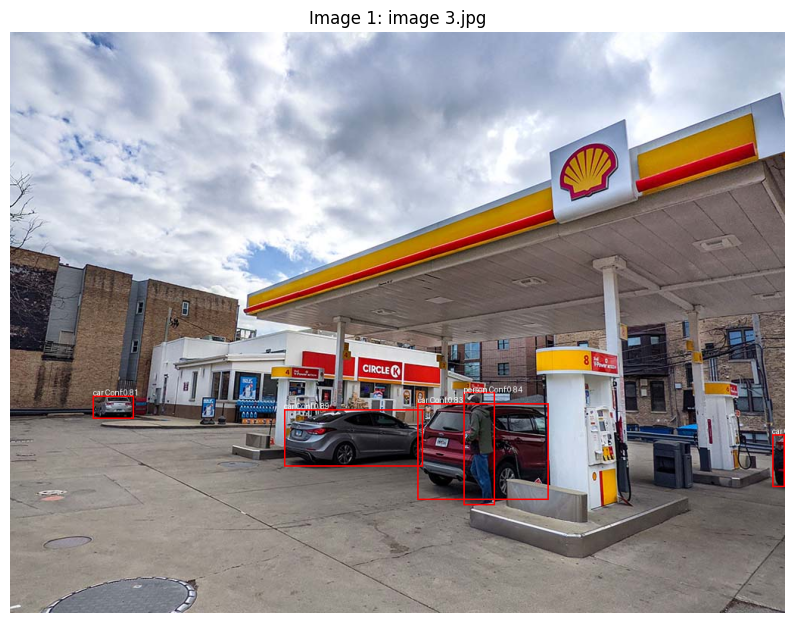

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_1.jpg

Processing /content/drive/MyDrive/Assignment3/image 4.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 4.jpg: 480x640 4 persons, 1 tie, 1 keyboard, 1251.7ms
Speed: 3.9ms preprocess, 1251.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


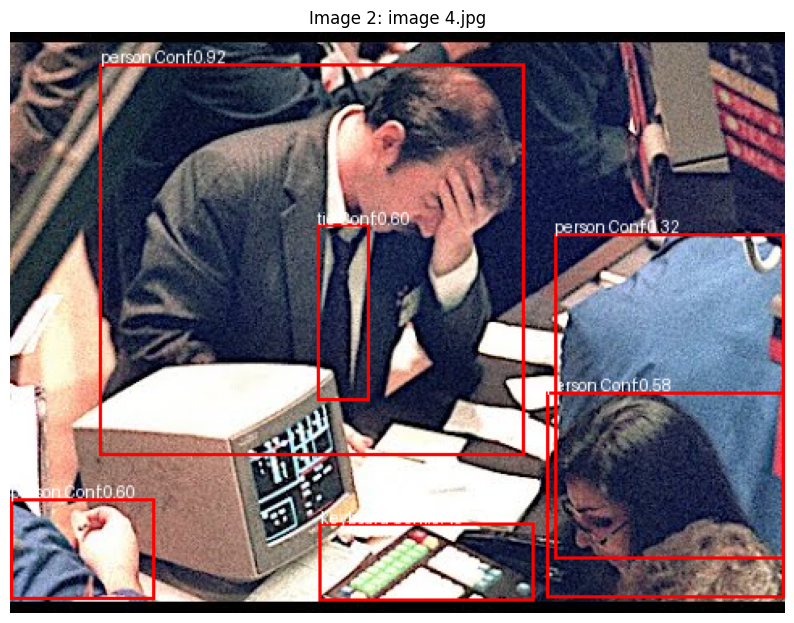

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_2.jpg

Processing /content/drive/MyDrive/Assignment3/image 5.jpeg...

image 1/1 /content/drive/MyDrive/Assignment3/image 5.jpeg: 384x640 4 persons, 1 sports ball, 1 skateboard, 1 tv, 1049.3ms
Speed: 4.3ms preprocess, 1049.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


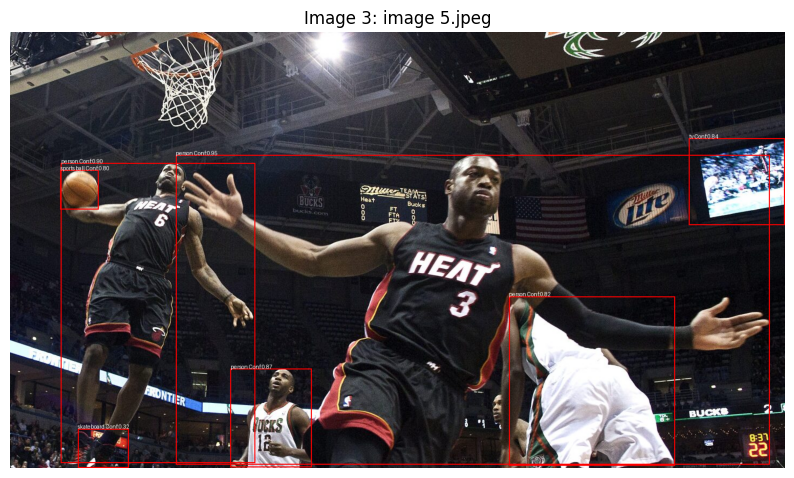

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_3.jpg

Processing /content/drive/MyDrive/Assignment3/image 6.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 6.jpg: 448x640 9 persons, 2 bicycles, 13 cars, 1 bus, 8 traffic lights, 2 handbags, 1 skateboard, 1139.3ms
Speed: 4.6ms preprocess, 1139.3ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


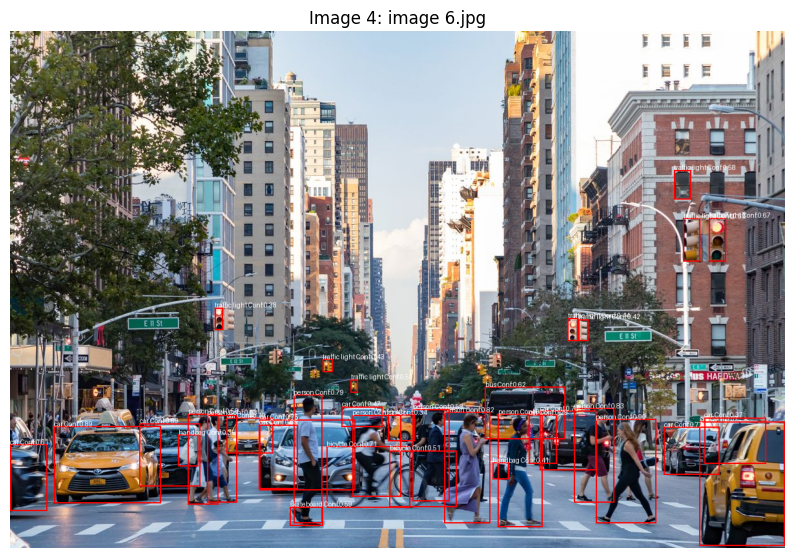

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_4.jpg

Processing /content/drive/MyDrive/Assignment3/image 7.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 7.jpg: 384x640 13 persons, 1 baseball bat, 1086.8ms
Speed: 3.9ms preprocess, 1086.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


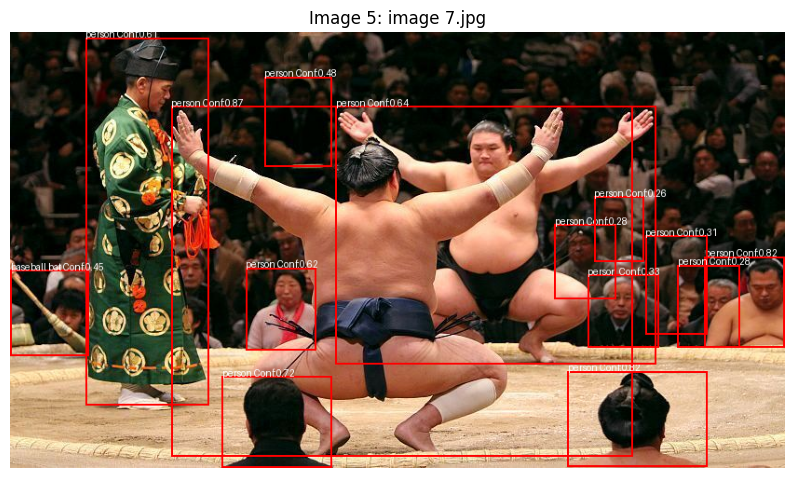

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_5.jpg

Processing /content/drive/MyDrive/Assignment3/image 1.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 1.jpg: 448x640 12 persons, 2 cars, 1 truck, 4 traffic lights, 1 bench, 1 bottle, 1 cup, 1 pizza, 1 cell phone, 1229.6ms
Speed: 3.5ms preprocess, 1229.6ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


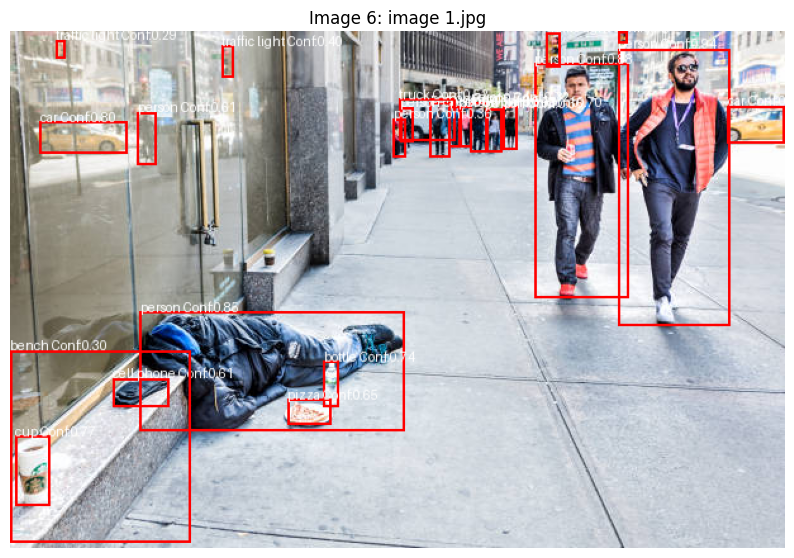

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_6.jpg

Processing /content/drive/MyDrive/Assignment3/image 2.jpg...

image 1/1 /content/drive/MyDrive/Assignment3/image 2.jpg: 448x640 1 person, 1 bottle, 1 potted plant, 1 tv, 1 vase, 1 teddy bear, 1320.6ms
Speed: 4.4ms preprocess, 1320.6ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)


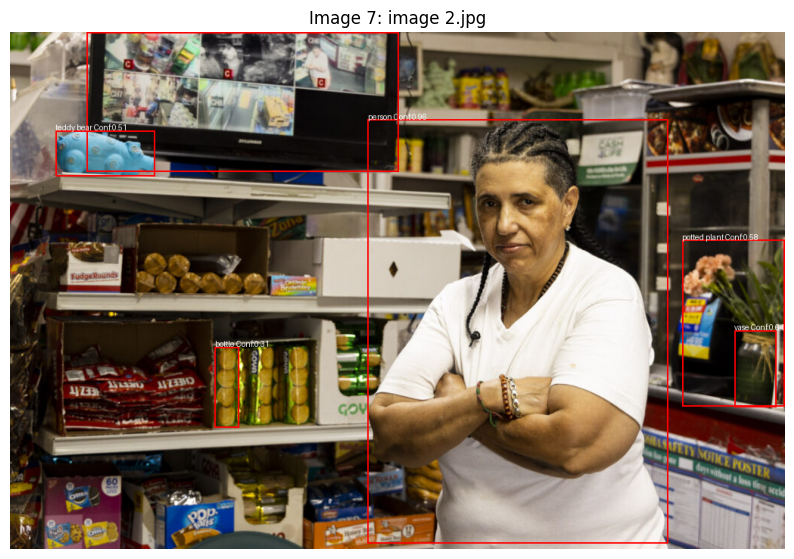

Annotated image saved as: /content/drive/MyDrive/Assignment3/annotated_image_7.jpg


Results Table


,Image,Detection Time (s),Number of Objects Detected,Classes Detected,Confidence Probabilities,Object Areas,Relative Positions
0,image 3.jpg,2.90,5,"[car, person, car, car, car]","[0.8948, 0.8449, 0.8293, 0.8071, 0.6705]","[13756.08, 6071.45, 22019.66, 1606.69, 1142.96]","[bottom-center, bottom-center, bottom-center, ..."
1,image 4.jpg,1.27,6,"[person, person, tie, person, keyboard, person]","[0.9166, 0.6018, 0.5986, 0.5796, 0.4263, 0.3231]","[63510.22, 5565.7, 3484.22, 18697.79, 6334.77,...","[middle-center, bottom-left, middle-center, bo..."
2,image 5.jpeg,1.08,7,"[person, person, person, tv, person, sports ba...","[0.946, 0.9027, 0.8718, 0.8371, 0.8177, 0.8032...","[633580.94, 200842.2, 27546.2, 28611.44, 96799...","[middle-center, middle-left, bottom-center, mi..."
3,image 6.jpg,1.19,36,"[person, car, car, person, person, person, per...","[0.9038, 0.8868, 0.8688, 0.8496, 0.8327, 0.816...","[15066.0, 19570.14, 25286.57, 11976.89, 9004.8...","[bottom-right, bottom-left, bottom-right, bott..."
4,image 7.jpg,1.11,14,"[person, person, person, person, person, perso...","[0.8665, 0.8241, 0.82, 0.7202, 0.6353, 0.6236,...","[186279.64, 15367.09, 8371.49, 11545.79, 95075...","[middle-center, bottom-right, middle-right, bo..."
5,image 1.jpg,1.25,24,"[person, person, person, car, car, cup, bottle...","[0.9371, 0.8822, 0.8476, 0.8344, 0.8024, 0.765...","[19278.21, 13724.11, 19517.74, 1283.73, 1702.7...","[top-right, top-right, middle-center, top-righ..."
6,image 2.jpg,1.35,6,"[person, tv, vase, potted plant, teddy bear, b...","[0.957, 0.9276, 0.6369, 0.5773, 0.5137, 0.3069]","[222057.0, 76016.42, 5565.61, 29744.48, 7921.1...","[middle-center, top-left, middle-right, middle..."



Results have been saved to: /content/drive/MyDrive/Assignment3/object_detection_with_areas_positions.csv


In [25]:
# Step 1: Install required libraries
!pip install ultralytics torch torchvision opencv-python pandas numpy

# Step 2: Import necessary libraries
from ultralytics import YOLO
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import os
import pandas as pd
import time  # For tracking detection time
from google.colab import drive

# Step 3: Mount Google Drive
drive.mount('/content/drive')

# Step 4: Initialize YOLO model (using YOLOv8 Medium weights)
model = YOLO("yolov8m.pt")

# Path to the folder containing the images
image_folder = "/content/drive/MyDrive/Assignment3"

# Get list of images (only jpg, png, or jpeg files)
image_paths = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith(('.jpg', '.jpeg', '.png'))]

# Limit the number of images to process to 7
image_paths = image_paths[:7]

# Step 5: Results storage
results_list = []

# Step 6: Loop through each image, predict, annotate, and save the results
for i, image_path in enumerate(image_paths):
    try:
        print(f'Processing {image_path}...')

        # Start the timer
        start_time = time.time()

        # Run YOLO prediction on the image
        results = model.predict(image_path)
        result = results[0]  # The result contains detected objects

        # Stop the timer and calculate detection time
        detection_time = time.time() - start_time

        # Extract YOLO detections: boxes, classes, and confidence
        detections = result.boxes.xyxy.cpu().numpy()  # Bounding boxes in [x1, y1, x2, y2] format
        scores = result.boxes.conf.cpu().numpy()  # Confidence scores
        classes = result.boxes.cls.cpu().numpy()  # Class IDs

        # Annotate the image with YOLO-detected objects
        image_annotated = Image.open(image_path).convert("RGB")
        draw = ImageDraw.Draw(image_annotated)
        try:
            font = ImageFont.truetype("arial.ttf", 20)
        except:
            font = ImageFont.load_default()

        # Calculate object areas and relative positions
        image_width, image_height = image_annotated.size
        object_areas = []
        object_positions = []
        for bbox, score, cls in zip(detections, scores, classes):
            x1, y1, x2, y2 = bbox
            width = x2 - x1
            height = y2 - y1
            area = width * height
            object_areas.append(area)

            # Determine relative position
            center_x = (x1 + x2) / 2
            center_y = (y1 + y2) / 2
            if center_x < image_width / 3:
                horizontal = "left"
            elif center_x > 2 * image_width / 3:
                horizontal = "right"
            else:
                horizontal = "center"

            if center_y < image_height / 3:
                vertical = "top"
            elif center_y > 2 * image_height / 3:
                vertical = "bottom"
            else:
                vertical = "middle"

            object_positions.append(f"{vertical}-{horizontal}")

            # Draw bounding box and class label
            cls_name = model.names[int(cls)]
            label_text = f"{cls_name} Conf:{score:.2f}"
            draw.rectangle([x1, y1, x2, y2], outline="red", width=2)
            draw.text((x1, y1 - 10), label_text, fill="white", font=font)

        # Display the annotated image
        plt.figure(figsize=(10, 10))
        plt.imshow(image_annotated)
        plt.axis('off')  # Turn off the axes for better visualization
        plt.title(f"Image {i+1}: {os.path.basename(image_path)}")
        plt.show()

        # Save the annotated image to Google Drive
        output_path = os.path.join(image_folder, f"annotated_image_{i+1}.jpg")
        image_annotated.save(output_path)

        print(f"Annotated image saved as: {output_path}\n")

        # Store results for this image
        results_list.append({
            'Image': os.path.basename(image_path),
            'Detection Time (s)': round(detection_time, 2),
            'Number of Objects Detected': len(detections),
            'Classes Detected': [model.names[int(cls)] for cls in classes],
            'Confidence Probabilities': [round(score, 4) for score in scores],
            'Object Areas': [round(area, 2) for area in object_areas],
            'Relative Positions': object_positions
        })

    except Exception as e:
        print(f"Error processing {image_path}: {e}")

# Step 7: Create a DataFrame to store and display the results
results_df = pd.DataFrame(results_list)

# Display results as a table
print("\nResults Table")
display(results_df)

# Step 8: Save the results as a CSV file in your Google Drive
csv_path = '/content/drive/MyDrive/Assignment3/object_detection_with_areas_positions.csv'
results_df.to_csv(csv_path, index=False)

# Print the location of the saved file
print(f"\nResults have been saved to: {csv_path}")
